In [14]:
import scanpy as sc
import os
import muon as mu

sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=150,
    facecolor="white",
    frameon=False,
)

In [3]:
output_path = os.path.join(os.getcwd(), '.data/output/')
os.listdir(output_path)

['E-MTAB12916_E-MTAB12919-QC-Norm.h5mu', 'E-MTAB12916_E-MTAB12919-QC.h5mu']

In [5]:
mdata = mu.read_h5mu(os.path.join(output_path, 'E-MTAB12916_E-MTAB12919-QC-Norm.h5mu'))
mdata

/home/ceger/miniforge3/envs/multiome_QC-env/lib/python3.10/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(
/home/ceger/miniforge3/envs/multiome_QC-env/lib/python3.10/site-packages/anndata/_core/anndata.py:430: FutureWarning: The dtype argument is deprecated and will be removed in late 2024.
  warnings.warn(


MuData object with n_obs × n_vars = 213373 × 3775615
  var:	'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
  2 modalities
    rna:	213373 x 70711
      obs:	'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'n_genes', 'doublet_score', 'predicted_doublet'
      var:	'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
      uns:	'scrublet'
      layers:	'log1p_norm'
    atac:	213373 x 3704904
      obs:	'sample', 'n_features_per_cell', 'total_fragment_counts', 'log_total_fragment_counts'
      var:	'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
      uns:	'atac', 'files'
      layers:	'log1p_norm'

In [6]:
rna = mdata.mod['rna']
rna

AnnData object with n_obs × n_vars = 213373 × 70711
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'n_genes', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet'
    layers: 'log1p_norm'

In [8]:
rna.layers

Layers with keys: log1p_norm

In [7]:
rna.X = rna.layers["log1p_norm"]
rna

AnnData object with n_obs × n_vars = 213373 × 70711
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'n_genes', 'doublet_score', 'predicted_doublet'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'scrublet'
    layers: 'log1p_norm'

In [10]:
sc.pp.highly_variable_genes(rna)

In [11]:
# setting highly variable as highly deviant to use scanpy 'use_highly_variable' argument in sc.pp.pca
sc.pp.pca(rna, svd_solver="arpack", use_highly_variable=True)

/home/ceger/miniforge3/envs/multiome_QC-env/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


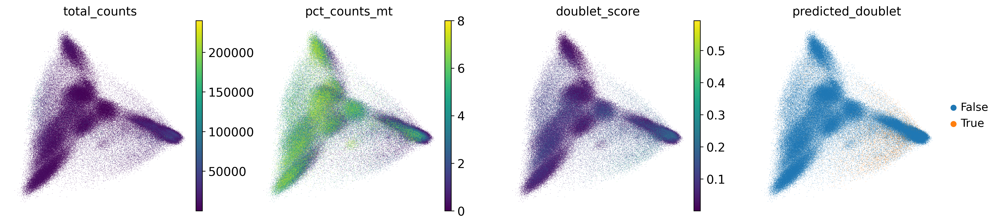

In [26]:
sc.pl.pca_scatter(rna, color=["total_counts", "pct_counts_mt", "doublet_score", "predicted_doublet"])

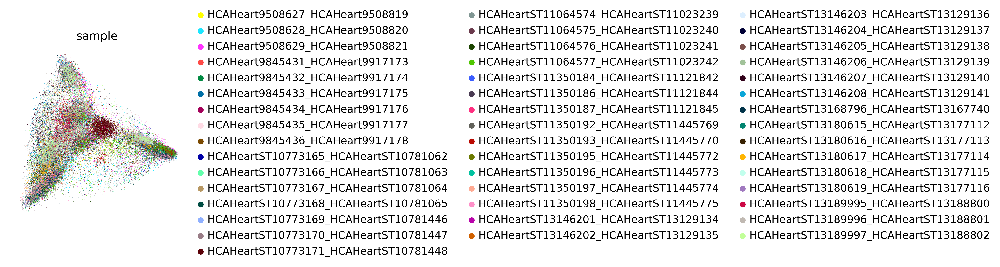

In [27]:

sc.pl.pca_scatter(rna, color='sample')

In [16]:
sc.tl.tsne(rna, use_rep="X_pca")

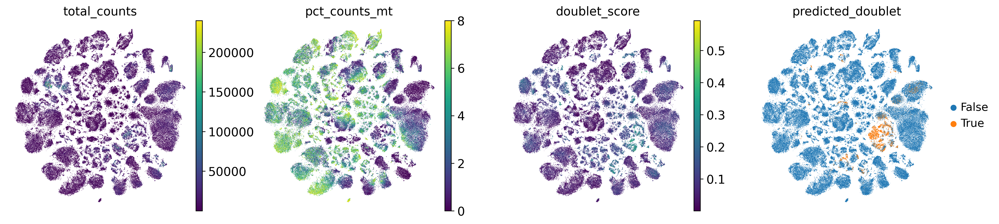

In [25]:
sc.pl.tsne(rna, color=["total_counts", "pct_counts_mt", "doublet_score", "predicted_doublet"])

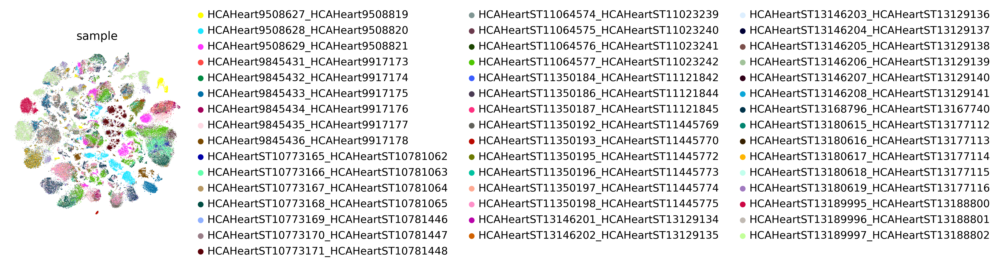

In [28]:
sc.pl.tsne(rna, color='sample')

In [29]:
sc.pp.neighbors(rna)
sc.tl.umap(rna)

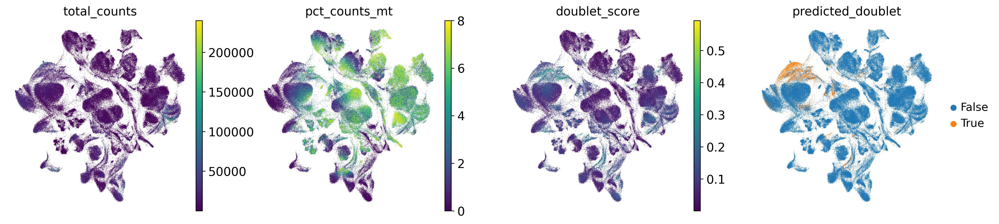

In [30]:
sc.pl.umap(rna, color=["total_counts", "pct_counts_mt", "doublet_score", "predicted_doublet"])

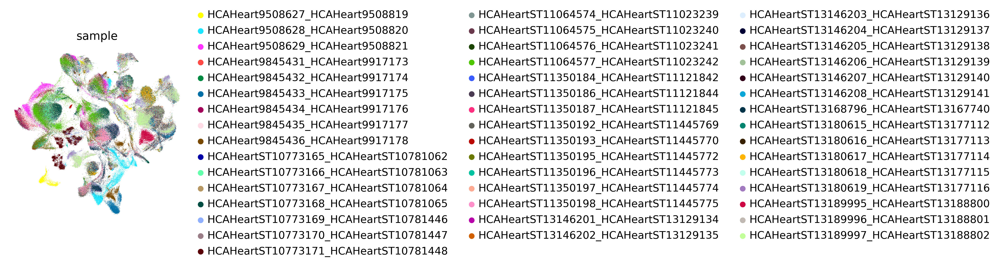

In [31]:

sc.pl.umap(rna, color='sample')